# 1. Setup and Libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import os
import re
import base64
import time
import io
from tqdm.notebook import tqdm
from dotenv import load_dotenv
from IPython.display import Audio, display, HTML, Markdown
import json
from pathlib import Path
from sklearn.model_selection import train_test_split
import librosa
import soundfile as sf
from pydub import AudioSegment

from google import genai
from google.genai import types
import vertexai
from vertexai.generative_models import GenerativeModel, Part                  

In [2]:
load_dotenv('../.env')
GEMINI_API_KEY = os.getenv("GOOGLE_API_KEY")
if not GEMINI_API_KEY:
    raise RuntimeError("GEMINI_API_KEY not found in .env.local")
else:
    print("GEMINI_API_KEY found in .env")

client = genai.Client(api_key=GEMINI_API_KEY)

GEMINI_2_5_FLASH_PREVIEW_05_20           = "gemini-2.5-flash-preview-05-20"
GEMINI_2_5_PRO_PREVIEW_06_05             = "gemini-2.5-pro-preview-06-05"
GEMINI_2_0_FLASH                         = "gemini-2.0-flash"
GEMINI_2_0_FLASH_EXPERIMENTAL            = "gemini-2.0-flash-exp"
GEMINI_2_0_FLASH_LITE                    = "gemini-2.0-flash-lite"
GEMINI_1_5_FLASH                         = "gemini-1.5-flash"
GEMINI_1_5_PRO                           = "gemini-1.5-pro"

GEMINI_API_KEY found in .env


In [3]:
os.environ["GOOGLE_APPLICATION_CREDENTIALS"] = "./bpi-internship-462819-ece668c2abd2.json"
# Verify the environment variable is set
print(f"GOOGLE_APPLICATION_CREDENTIALS set to: {os.environ.get('GOOGLE_APPLICATION_CREDENTIALS')}")

GOOGLE_APPLICATION_CREDENTIALS set to: ./bpi-internship-462819-ece668c2abd2.json


In [4]:
AUDIO_ROOT = "audio_emotions/files"
FULL_URL = "full_audio"

### 1.1 Helper Functions

In [5]:
def display_df(df: pd.DataFrame):
    html = df.head(300).to_html(index=False)

    scrollable = f'''
    <div style="
        max-height: 300px;
        max-width: 100%;
        overflow: auto;
        border: 1px solid #ccc;
        white-space: nowrap;
    ">
        {html}
    </div>
    '''

    display(HTML(scrollable))

In [6]:
def get_audio_and_path(df, idx, emotion):
    """
    Given your DataFrame and row index:
      - looks up the `set_id`
      - builds: AUDIO_ROOT/<set_id>/<emotion>.wav
      - returns: (Audio player, full_path, base64-encoded bytes)
    """
    # sanity checks
    if 'set_id' not in df.columns:
        raise KeyError("DataFrame must contain a 'set_id' column")
    
    # grab the set identifier
    sid = df.at[idx, 'set_id']
    
    # build filename and path
    filename   = f"{emotion}.wav"
    full_path  = os.path.join(AUDIO_ROOT, sid, filename)
    
    # create IPython Audio player (URL vs. local file)
    if full_path.startswith(("http://", "https://")):
        player = Audio(url=full_path)
        # fetch bytes remotely
        import requests
        resp = requests.get(full_path)
        resp.raise_for_status()
        audio_bytes = resp.content
    else:
        player = Audio(filename=full_path)
        with open(full_path, "rb") as f:
            audio_bytes = f.read()
    
    # base64 encode for any downstream use
    audio_base64 = base64.b64encode(audio_bytes).decode("utf-8")
    
    return player, full_path, audio_base64

In [7]:
def get_audio_and_path_with_label(df, idx):
    """
    Given the expanded DataFrame and a row index, returns:
      - player: IPython Audio instance
      - full_path: the URL or filesystem path to the .wav
      - audio_base64: Base64-encoded bytes of the file
      - output: the emotion output for this row
    """
    # sanity checks
    for col in ("relative_path", "output"):
        if col not in df.columns:
            raise KeyError(f"DataFrame must contain '{col}' column")
    
    # pull values
    path = df.at[idx, "relative_path"]
    output = df.at[idx, "output"]
    
    # build Audio player & load bytes
    if path.startswith(("http://", "https://")):
        player = Audio(url=path)
        import requests
        resp = requests.get(path)
        resp.raise_for_status()
        audio_bytes = resp.content
    else:
        player = Audio(filename=path)
        with open(path, "rb") as f:
            audio_bytes = f.read()
    
    # encode
    audio_base64 = base64.b64encode(audio_bytes).decode("utf-8")
    
    return player, path, audio_base64, output

In [8]:
def get_audio_full(df, idx):
    # Ensure required columns exist
    if 'RelativeFileName' not in df.columns:
        raise KeyError("DataFrame must contain 'RelativeFileName' column")

    # Relative path to the audio file
    rel_path = df.at[idx, 'RelativeFileName']

    # Construct full path/URL
    full_path = f"{FULL_URL.rstrip('/')}/{rel_path.lstrip('/')}"

    # Create the Audio player (URL or local file)
    if FULL_URL.startswith(("http://", "https://")):
        player = Audio(url=full_path)
    else:
        player = Audio(filename=full_path)

    # Read the audio bytes and Base64-encode
    with open(full_path, "rb") as f:
        audio_bytes = f.read()
    audio_base64 = base64.b64encode(audio_bytes).decode("utf-8")

    return player, full_path, audio_base64

In [9]:
def clean(t):
    # 1) strip tags + punctuation
    t = re.sub(r"\[.*?\]", "", t)
    t = re.sub(r"[^\w\s]", "", t)
    t = t.lower()
    # 2) drop filler/pronoun words
    t = re.sub(r"\b(po|ho|ah|um|eh|ko|mo)\b", "", t)
    # 3) collapse pag xxx → pagxxx
    t = re.sub(r"\bpag\s+(\w+)", r"pag\1", t)
    # 4) dedupe repeated words
    t = re.sub(r"\b(\w+)( \1)+\b", r"\1", t)
    # 5) normalize whitespace
    return re.sub(r"\s+", " ", t).strip()

# 2. Preparing the Data

### 2.1 Emotions Dataset

In [10]:
df = pd.read_csv("speech_emotions.csv")
print("Shape: ", df.shape)
display_df(df)

Shape:  (20, 6)


Unnamed: 0,set_id,text,gender,age,country
0,00026029e0--64991b6eef1fe70609d48edc,The delicious aroma of freshly baked bread filled the bakery.,MALE,29,ZA
1,00026029e0--64991b72e0daf97163c09c66,I enjoy taking long walks in the peaceful countryside.,FEMALE,42,NG
2,00026029e0--64991b7fd94c0d5726dec353,The suspenseful novel kept me on the edge of my seat.,FEMALE,29,VN
3,00026029e0--64991b907f82d9763944eba2,They celebrated their anniversary with a romantic candlelit dinner.,FEMALE,20,PK
4,00026029e0--64991bf2ffab6240f9f2418b,The diligent student earned top marks for her exceptional work.,MALE,30,PK
5,00026029e0--64991bfc63d8b20f56d0e1fb,The rhythmic beat of the drums echoed through the concert hall.,MALE,18,IN
6,00026029e0--64991c0dd94c0d5726df032a,The curious child eagerly explored the vast museum exhibits.,MALE,21,MX
7,00026029e0--64991c3e63d8b20f56d0eeba,The innovative design of the new smartphone impressed tech enthusiasts.,FEMALE,20,PK
8,00026029e0--64991c9e7f82d97639452402,The innovative design of the new smartphone impressed tech enthusiasts.,MALE,34,NG
9,00026029e0--64992031e0daf97163c20229,The breathtaking view from the mountaintop took my breath away.,FEMALE,31,KE


In [11]:
player, path, b64 = get_audio_and_path(df, idx=0, emotion="joyfully")
print(path)
display(player)

audio_emotions/files\00026029e0--64991b6eef1fe70609d48edc\joyfully.wav


In [12]:
def expand_emotion_variations(
    df: pd.DataFrame,
    audio_root: str = "audio_emotions/files",
    cloud_bucket: str = "bpi-tunings",
    cloud_prefix: str = "audio-emotions"
) -> pd.DataFrame:
    """
    Expand each set_id into one row per actual audio file,
    adding:
      - relative_path: local path under audio_root
      - output: filename stem (emotion)
      - file_type: file extension (without dot)
      - cloud_link: GCS URI under gs://<cloud_bucket>/<cloud_prefix>/<relative_path>
    """
    records = []
    for _, row in df.iterrows():
        set_id = row["set_id"]
        dir_path = os.path.join(audio_root, set_id)
        if not os.path.isdir(dir_path):
            continue
        for fname in os.listdir(dir_path):
            stem, ext = os.path.splitext(fname)
            if ext.lower() not in {".wav", ".mp3", ".mpeg", ".flac", ".ogg"}:
                continue
            rec = row.to_dict()
            rel = f"{audio_root}/{set_id}/{fname}"
            rec["relative_path"] = rel
            rec["output"]        = stem
            rec["file_type"]     = ext.lstrip(".").lower()
            rec["cloud_link"]    = f"gs://{cloud_bucket}/{rel}"
            records.append(rec)
    return pd.DataFrame.from_records(records)

In [13]:
emotions_df = expand_emotion_variations(df)
display_df(emotions_df)

Unnamed: 0,set_id,text,gender,age,country,relative_path,output,file_type,cloud_link
0,00026029e0--64991b6eef1fe70609d48edc,The delicious aroma of freshly baked bread filled the bakery.,MALE,29,ZA,audio_emotions/files/00026029e0--64991b6eef1fe70609d48edc/euphoric.wav,euphoric,wav,gs://bpi-tunings/audio_emotions/files/00026029e0--64991b6eef1fe70609d48edc/euphoric.wav
0,00026029e0--64991b6eef1fe70609d48edc,The delicious aroma of freshly baked bread filled the bakery.,MALE,29,ZA,audio_emotions/files/00026029e0--64991b6eef1fe70609d48edc/joyfully.wav,joyfully,wav,gs://bpi-tunings/audio_emotions/files/00026029e0--64991b6eef1fe70609d48edc/joyfully.wav
0,00026029e0--64991b6eef1fe70609d48edc,The delicious aroma of freshly baked bread filled the bakery.,MALE,29,ZA,audio_emotions/files/00026029e0--64991b6eef1fe70609d48edc/sad.wav,sad,wav,gs://bpi-tunings/audio_emotions/files/00026029e0--64991b6eef1fe70609d48edc/sad.wav
0,00026029e0--64991b6eef1fe70609d48edc,The delicious aroma of freshly baked bread filled the bakery.,MALE,29,ZA,audio_emotions/files/00026029e0--64991b6eef1fe70609d48edc/surprised.wav,surprised,wav,gs://bpi-tunings/audio_emotions/files/00026029e0--64991b6eef1fe70609d48edc/surprised.wav
1,00026029e0--64991b72e0daf97163c09c66,I enjoy taking long walks in the peaceful countryside.,FEMALE,42,NG,audio_emotions/files/00026029e0--64991b72e0daf97163c09c66/euphoric.wav,euphoric,wav,gs://bpi-tunings/audio_emotions/files/00026029e0--64991b72e0daf97163c09c66/euphoric.wav
1,00026029e0--64991b72e0daf97163c09c66,I enjoy taking long walks in the peaceful countryside.,FEMALE,42,NG,audio_emotions/files/00026029e0--64991b72e0daf97163c09c66/joyfully.wav,joyfully,wav,gs://bpi-tunings/audio_emotions/files/00026029e0--64991b72e0daf97163c09c66/joyfully.wav
1,00026029e0--64991b72e0daf97163c09c66,I enjoy taking long walks in the peaceful countryside.,FEMALE,42,NG,audio_emotions/files/00026029e0--64991b72e0daf97163c09c66/sad.wav,sad,wav,gs://bpi-tunings/audio_emotions/files/00026029e0--64991b72e0daf97163c09c66/sad.wav
1,00026029e0--64991b72e0daf97163c09c66,I enjoy taking long walks in the peaceful countryside.,FEMALE,42,NG,audio_emotions/files/00026029e0--64991b72e0daf97163c09c66/surprised.wav,surprised,wav,gs://bpi-tunings/audio_emotions/files/00026029e0--64991b72e0daf97163c09c66/surprised.wav
2,00026029e0--64991b7fd94c0d5726dec353,The suspenseful novel kept me on the edge of my seat.,FEMALE,29,VN,audio_emotions/files/00026029e0--64991b7fd94c0d5726dec353/euphoric.wav,euphoric,wav,gs://bpi-tunings/audio_emotions/files/00026029e0--64991b7fd94c0d5726dec353/euphoric.wav
2,00026029e0--64991b7fd94c0d5726dec353,The suspenseful novel kept me on the edge of my seat.,FEMALE,29,VN,audio_emotions/files/00026029e0--64991b7fd94c0d5726dec353/joyfully.wav,joyfully,wav,gs://bpi-tunings/audio_emotions/files/00026029e0--64991b7fd94c0d5726dec353/joyfully.wav


In [14]:
player, full_path, b64, emotion = get_audio_and_path_with_label(emotions_df, idx=20)

print(full_path)       
print("label:", emotion)
display(player)        

audio_emotions/files/00026029e0--64991bfc63d8b20f56d0e1fb/euphoric.wav
label: euphoric


### 2.2 Full Audio Dataset

In [15]:
full_df = pd.read_csv("all_domains_combined.csv")
print("Shape: ", full_df.shape)
display_df(full_df)

Shape:  (30, 11)


RecordingId,Domain,Duration,SampleRate,BitDepth,Channels,LeftChannelRole,LeftChannelSpeaker,RightChannelRole,RightChannelSpeaker,RelativeFileName
4f583fc1-a97f-4e2d-94ee-59bac143af45,banking,00:03:13.32000732421875,8000,16,2,agent,AAF38662-6FDA-48EB-A673-F5F7A50C48DB,customer,6106C194-2F98-4C04-B0DC-666E2B3D10B9,Audio/4f583fc1-a97f-4e2d-94ee-59bac143af45.wav
f3b5af36-8ee0-452b-b2f2-a9a4f5f9bde4,banking,00:03:45.24000549316406,8000,16,2,agent,AAF38662-6FDA-48EB-A673-F5F7A50C48DB,customer,84E54BBA-78F8-4104-82A1-C5919E4EFF7B,Audio/f3b5af36-8ee0-452b-b2f2-a9a4f5f9bde4.wav
174bf590-3d57-4c46-9cc8-b15a2f584b14,banking,00:03:55.3800048828125,8000,16,2,agent,882145B4-2242-46F5-BE34-08783B7C919C,customer,6106C194-2F98-4C04-B0DC-666E2B3D10B9,Audio/174bf590-3d57-4c46-9cc8-b15a2f584b14.wav
2002c4cd-d39c-4610-a2ac-78ab3d66422d,banking,00:03:23.05999755859375,8000,16,2,agent,882145B4-2242-46F5-BE34-08783B7C919C,customer,62187B2D-1F99-438E-BD44-6990222C3852,Audio/2002c4cd-d39c-4610-a2ac-78ab3d66422d.wav
12ab8793-cd70-49d0-a64b-6ccee12e8fd0,banking,00:03:17.539993286132812,8000,16,2,agent,AAF38662-6FDA-48EB-A673-F5F7A50C48DB,customer,16E2FDB6-9B2D-4CB8-A22C-80448BCFA5E9,Audio/12ab8793-cd70-49d0-a64b-6ccee12e8fd0.wav
96725fab-7f97-4320-a7c7-605c894fda19,banking,00:03:23.6199951171875,8000,16,2,agent,85D21F93-60AF-4872-A46D-B815119BB8FF,customer,E4656C37-FE08-4A5F-AF45-10F46915D2EC,Audio/96725fab-7f97-4320-a7c7-605c894fda19.wav
5c3e2ffa-7229-40e2-ae85-e39aa6268b15,banking,00:03:16.199996948242188,8000,16,2,agent,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,customer,E4656C37-FE08-4A5F-AF45-10F46915D2EC,Audio/5c3e2ffa-7229-40e2-ae85-e39aa6268b15.wav
12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,2,agent,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,customer,6106C194-2F98-4C04-B0DC-666E2B3D10B9,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav
bc4b2543-21b2-4fcc-bd7c-78eb6b19f3b6,insurance,00:03:27.899993896484375,8000,16,2,agent,B96ADAE4-D9C9-434D-A184-38F1C502775D,customer,6106C194-2F98-4C04-B0DC-666E2B3D10B9,Audio/bc4b2543-21b2-4fcc-bd7c-78eb6b19f3b6.wav
11978114-5357-4f58-b3fe-31ef1d8f64bc,insurance,00:03:28.740005493164062,8000,16,2,agent,B96ADAE4-D9C9-434D-A184-38F1C502775D,customer,DB2C7182-A0C0-4BBB-A070-143029D751FA,Audio/11978114-5357-4f58-b3fe-31ef1d8f64bc.wav


In [16]:
audio_idx = 2

full_audio, full_audio_url, full_audio_base64 = get_audio_full(full_df, audio_idx)

print("File Path: ", full_audio_url)

display(Markdown("---\n### Audio:"))
display(full_audio)

File Path:  full_audio/Audio/174bf590-3d57-4c46-9cc8-b15a2f584b14.wav


---
### Audio:

# 3. Audio Emotion Analysis

### 3.1 Sample Audio Detection

In [17]:
def detect_audio_emotion(audio_b64):
    """
    Sends base64-encoded WAV audio to the model and returns the detected emotion/tone
    from 4 categories: euphoric, joyfully, sad, surprised.
    
    Returns:
        str: One of the four emotion categories
    """
    audio_part = {
        "inlineData": {
            "mimeType": "audio/wav",
            "data": audio_b64
        }
    }
    text_part = {
        "text": (
            "You are a world-class audio emotion detection engine. "
            "Analyze the emotional tone of the following audio and classify it into "
            "exactly ONE of these 4 categories: euphoric, joyfully, sad, surprised. "
            "Consider vocal patterns, tone, pitch, pace, and overall emotional expression. "
            "Respond with only the single category name, no additional text or formatting:\n\n"
            "(Begin audio input)"
        )
    }
    resp = client.models.generate_content(
        model=GEMINI_2_5_PRO_PREVIEW_06_05,
        contents=[audio_part, text_part]
    )
    
    # Clean and validate the response
    emotion = resp.text.strip().lower()
    
    # Ensure the response is one of the valid categories
    valid_emotions = ["euphoric", "joyfully", "sad", "surprised"]
    if emotion in valid_emotions:
        return emotion
    else:
        return "error detecting emotion"

In [18]:
emotion = detect_audio_emotion(b64)

display(Markdown(f"**Detected Emotion:**  \n\n{emotion}"))

**Detected Emotion:**  

sad

### 3.2 Evaluate Gemini Zero Shot Accuracy

In [19]:
def evaluate_emotion_accuracy(
    df: pd.DataFrame,
    max_per_minute: int = 4
) -> (pd.DataFrame, float):
    """
    For each row in `df` (which must contain at least 'relative_path', 'text', 'output'),
    fetch and encode the audio, run detect_audio_emotion, and compare to the ground truth.

    Returns:
      - results: DataFrame with columns
          ['relative_path', 'text', 'ground_output', 'predicted_output']
      - accuracy: proportion of correct predictions (float in [0,1])
    """
    records = []
    total = len(df)
    correct = 0

    window_start = time.monotonic()
    calls_made   = 0

    for idx in tqdm(df.index, desc="Evaluating emotion", unit="row"):
        # --- rate limiting ---
        now = time.monotonic()
        if now - window_start >= 60:
            window_start = now
            calls_made = 0
        if calls_made >= max_per_minute:
            to_sleep = 60 - (now - window_start)
            if to_sleep > 0:
                time.sleep(to_sleep)
            window_start = time.monotonic()
            calls_made = 0

        # --- fetch and label ---
        player, path, audio_b64, ground = get_audio_and_path_with_label(df, idx)

        # --- predict ---
        pred = detect_audio_emotion(audio_b64)

        # --- record result ---
        records.append({
            "relative_path": path,
            "text":          df.at[idx, "text"],
            "ground_output":  ground,
            "predicted_output": pred
        })

        if pred == ground:
            correct += 1

        calls_made += 1

    results_df = pd.DataFrame.from_records(records)
    accuracy = correct / total if total > 0 else 0.0

    return results_df, accuracy

In [21]:
results_df, acc = evaluate_emotion_accuracy(emotions_df, 100)
print(f"Emotion-detection accuracy: {acc:.2%}")
display_df(results_df)

Evaluating emotion:   0%|          | 0/72 [00:00<?, ?row/s]

Emotion-detection accuracy: 29.17%


relative_path,text,ground_output,predicted_output
audio_emotions/files/00026029e0--64991b6eef1fe70609d48edc/euphoric.wav,The delicious aroma of freshly baked bread filled the bakery.,euphoric,sad
audio_emotions/files/00026029e0--64991b6eef1fe70609d48edc/joyfully.wav,The delicious aroma of freshly baked bread filled the bakery.,joyfully,sad
audio_emotions/files/00026029e0--64991b6eef1fe70609d48edc/sad.wav,The delicious aroma of freshly baked bread filled the bakery.,sad,sad
audio_emotions/files/00026029e0--64991b6eef1fe70609d48edc/surprised.wav,The delicious aroma of freshly baked bread filled the bakery.,surprised,sad
audio_emotions/files/00026029e0--64991b72e0daf97163c09c66/euphoric.wav,I enjoy taking long walks in the peaceful countryside.,euphoric,sad
audio_emotions/files/00026029e0--64991b72e0daf97163c09c66/joyfully.wav,I enjoy taking long walks in the peaceful countryside.,joyfully,joyfully
audio_emotions/files/00026029e0--64991b72e0daf97163c09c66/sad.wav,I enjoy taking long walks in the peaceful countryside.,sad,sad
audio_emotions/files/00026029e0--64991b72e0daf97163c09c66/surprised.wav,I enjoy taking long walks in the peaceful countryside.,surprised,joyfully
audio_emotions/files/00026029e0--64991b7fd94c0d5726dec353/euphoric.wav,The suspenseful novel kept me on the edge of my seat.,euphoric,surprised
audio_emotions/files/00026029e0--64991b7fd94c0d5726dec353/joyfully.wav,The suspenseful novel kept me on the edge of my seat.,joyfully,sad


### 3.3 Fine-tuning Gemini

In [ ]:
def export_jsonl_dataset_split(
    df,
    train_output_path: str,
    test_output_path: str,
    test_size: float = 0.2,
    random_state: int = 42
):
    """
    Splits `df` into 80/20 train/test, then writes two JSONL files.
    
    Each record has the format:
    {
      "contents": [
        {
          "role": "user",
          "parts": [
            {
              "fileData": {
                "mimeType": "audio/<file_type>",
                "fileUri": "<cloud_link>"
              }
            },
            {
              "text": "Detect the emotion of the tone: one of euphoric, joyfully, sad, surprised."
            }
          ]
        },
        {
          "role": "model",
          "parts": [
            {
              "text": "<output>"
            }
          ]
        }
      ]
    }
    """
    # 1) Train/test split
    train_df, test_df = train_test_split(
        df,
        test_size=test_size,
        random_state=random_state,
        shuffle=True
    )

    def _write_jsonl(sub_df, path):
        path = Path(path)
        path.parent.mkdir(parents=True, exist_ok=True)
        with path.open("w", encoding="utf-8") as f:
            for _, row in sub_df.iterrows():
                record = {
                    "contents": [
                        {
                            "role": "user",
                            "parts": [
                                {
                                    "fileData": {
                                        "mimeType": f"audio/{row['file_type']}",
                                        "fileUri": row["cloud_link"]
                                    }
                                },
                                {
                                    "text": (
                                        "Detect the emotion of the tone: one of "
                                        "euphoric, joyfully, sad, surprised."
                                    )
                                }
                            ]
                        },
                        {
                            "role": "model",
                            "parts": [
                                { "text": row["output"] }
                            ]
                        }
                    ]
                }
                f.write(json.dumps(record, ensure_ascii=False) + "\n")

    # 2) Write out train and test JSONL
    _write_jsonl(train_df, train_output_path)
    _write_jsonl(test_df, test_output_path)

    print(f"Exported {len(train_df)} records to {train_output_path}")
    print(f"Exported {len(test_df)} records to {test_output_path}")

In [ ]:
export_jsonl_dataset_split(
    emotions_df,
    train_output_path="emotions_train.jsonl",
    test_output_path="emotions_test.jsonl",
    test_size=0.2,
    random_state=123
)

Exported 57 records to emotions_train.jsonl
Exported 15 records to emotions_test.jsonl


In [ ]:
tune_accuracy = pd.read_csv("accuracy.csv")
tune_accuracy = tune_accuracy.rename(columns={
    "TimeSeries ID": "Epoch",
    "projects/431714973110/locations/us-central1/tensorboards/950888442026262528/experiments/tuning-experiment-20250615190857981976/runs/tuning-experiment-run-20250615190857981976/timeSeries/3241884224965312512": "Training",
    "projects/431714973110/locations/us-central1/tensorboards/950888442026262528/experiments/tuning-experiment-20250615190857981976/runs/tuning-experiment-run-20250615190857981976/timeSeries/8430030995696123904": "Validation"
})

In [ ]:
display_df(tune_accuracy)

Epoch,Training,Validation
43,0.838095,0.806451678276062
42,0.850962,undefined
41,0.833333,undefined
40,0.843602,0.7983871698379517
39,0.840376,undefined
38,0.841346,undefined
37,0.800971,undefined
36,0.853211,undefined
35,0.821256,0.782258152961731
34,0.813953,undefined


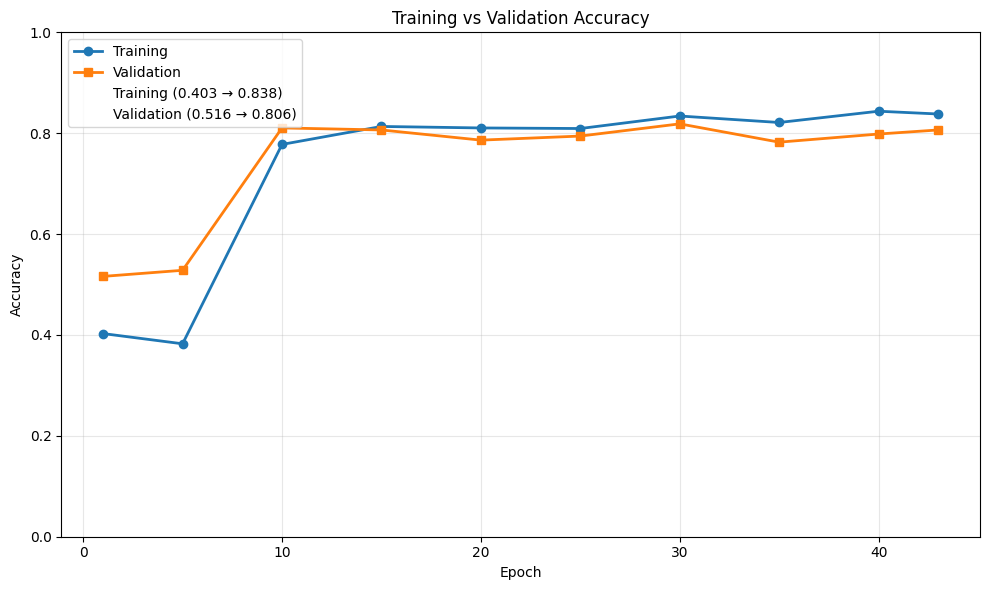

In [ ]:
# Prepare data
data = tune_accuracy.copy()
data[['Training', 'Validation']] = data[['Training', 'Validation']].apply(pd.to_numeric, errors='coerce')
data = data.dropna()

# Plot
fig, ax = plt.subplots(figsize=(10, 6))
ax.plot(data['Epoch'], data['Training'], 'o-', label=f'Training', linewidth=2)
ax.plot(data['Epoch'], data['Validation'], 's-', label=f'Validation', linewidth=2)

# Add start/end values as text in legend
train_range = f"({data['Training'].iloc[-1]:.3f} → {data['Training'].iloc[0]:.3f})"
val_range = f"({data['Validation'].iloc[-1]:.3f} → {data['Validation'].iloc[0]:.3f})"

ax.plot([], [], ' ', label=f'Training {train_range}')
ax.plot([], [], ' ', label=f'Validation {val_range}')

ax.set_title('Training vs Validation Accuracy')
ax.set_xlabel('Epoch')
ax.set_ylabel('Accuracy')
ax.set_ylim(0, 1)
ax.grid(True, alpha=0.3)
ax.legend()
plt.tight_layout()
plt.show()

In [ ]:
def predict_tone_from_audio(audio_file_path):
    """Sends a prediction request to a deployed, fine-tuned Gemini model for tone analysis."""

    # --- Your project and model details ---
    project_id = "bpi-internship-462819"
    endpoint_id = "9129549610145021952"
    location = "us-central1"

    # --- 1. Initialize the Vertex AI SDK ---
    vertexai.init(project=project_id, location=location)

    # --- 2. Load your fine-tuned model from the endpoint ---
    # The SDK knows how to talk to a Gemini model endpoint.
    tuned_model = GenerativeModel(f"projects/{project_id}/locations/{location}/endpoints/{endpoint_id}")

    # --- 3. Load and prepare the audio file ---
    # This part is simplified using the SDK's 'Part' object.
    try:
        # Load audio data into memory
        audio, sr = librosa.load(audio_file_path, sr=None)
        
        # Create an in-memory WAV file
        buffer = io.BytesIO()
        sf.write(buffer, audio, sr, format='wav')
        audio_bytes = buffer.getvalue()

        # Create a Part object for the audio
        audio_part = Part.from_data(data=audio_bytes, mime_type="audio/wav")
        
    except Exception as e:
        print(f"Error processing audio file: {e}")
        return None

    # --- 4. Prepare the prompt and make the prediction request ---
    # The structure [audio_part, text_part] mirrors your training data.
    prompt = "Detect the emotion of the tone: one of euphoric, joyfully, sad, surprised."
    
    # The generate_content method is the correct way to call Gemini
    response = tuned_model.generate_content([audio_part, prompt])

    # --- 5. Return the result ---
    # The prediction is directly available in the 'text' attribute of the response.
    try:
        return response.text
    except Exception as e:
        print(f"Failed to get text from response. Full response: {response}")
        return None

In [ ]:
tone_prediction = predict_tone_from_audio(full_path)

if tone_prediction:
    print(f"Predicted Tone: {tone_prediction}")

Predicted Tone: sad


# 4. Speaker Diarization

In [ ]:
def diarize_and_display(audio_path: str, model: str, use_json_mode: bool = True):
    """
    Performs speaker diarization on a long audio file (~5m) via Gemini,
    parses the JSON response correctly, returns a DataFrame of
    [speaker, transcription], and displays metadata plus an interactive audio player & table.

    Returns:
        pd.DataFrame: columns ['speaker', 'text']
    """
    # Load audio and get duration
    audio = AudioSegment.from_file(audio_path)
    duration_sec = len(audio) / 1000.0

    # Read & encode audio
    with open(audio_path, "rb") as f:
        audio_bytes = f.read()
    audio_b64 = base64.b64encode(audio_bytes).decode("utf-8")

    # Prepare request parts
    audio_part = {
        "inlineData": {
            "mimeType": f"audio/{audio_path.split('.')[-1]}",
            "data": audio_b64
        }
    }
    text_part = {
        "text": (
            "You are a speaker-diarization engine. "
            "For the audio input, return a JSON object with a top-level `segments` array. "
            "Each segment must have: `speaker` (string) and `text` (transcript)."
        )
    }

    # Build request
    request_kwargs = {"model": model, "contents": [audio_part, text_part]}
    if use_json_mode:
        schema = {
            "type": "object",
            "properties": {
                "segments": {
                    "type": "array",
                    "items": {
                        "type": "object",
                        "properties": {
                            "speaker": {"type": "string"},
                            "text":    {"type": "string"}
                        },
                        "required": ["speaker", "text"]
                    }
                }
            },
            "required": ["segments"]
        }
        cfg = types.GenerateContentConfig(
            response_mime_type="application/json",
            response_schema=schema
        )
        request_kwargs["config"] = cfg

    resp = client.models.generate_content(**request_kwargs)

    # Parse JSON response
    try:
        result = json.loads(resp.text)
    except json.JSONDecodeError as e:
        raise ValueError(f"Failed to parse JSON from Gemini: {e}")

    segments = result.get("segments", [])
    df = pd.DataFrame(segments)[["speaker", "text"]]

    # Metadata
    total_turns  = len(df)
    num_speakers = df["speaker"].nunique()
    duration_str = f"{int(duration_sec//60):02d}:{int(duration_sec%60):02d}"

    # Display
    display(Markdown(
        f"**Audio Duration:** {duration_str}  \n"
        f"**Total Turns:** {total_turns}  \n"
        f"**Number of Speakers:** {num_speakers}"
    ))
    display(Audio(audio_path))
    display(HTML(df.to_html(index=False)))

    return df

In [ ]:
diarized_df = diarize_and_display(full_audio_url, GEMINI_2_5_PRO_PREVIEW_06_05)
display_df(diarized_df)

**Audio Duration:** 03:55  
**Total Turns:** 35  
**Number of Speakers:** 2

speaker,text
SPEAKER_00,Magandang araw. Maraming salamat sa pagtawag sa Bangko de Pilipinas. Ano po may tutulong ko?
SPEAKER_01,"Magandang araw. Ako si Ellen. Ah, sa ah naka-schedule na mabayaran ang sweldo ko ngayong linggo. Pero nasa kalagitnaan ng linggo ang bank holidays. Ah, gusto ko sanang malaman kung matatanggap ko ba 'yung pera bago sumapit ang bank holiday o pagkatapos ng bank holiday."
SPEAKER_00,"Ah, magandang katanungan po iyan. Ah, matanong ko lang po, ma'am, kung kailan po ginawa ang paglipat?"
SPEAKER_01,Ginawa ko 'yung paglipat sa pagsisimula ng linggo.
SPEAKER_00,"Ah, o sige po. Ah, may tanong ko na lang din po kung alam niyo po ba kung aling bangko po nagmula ito?"
SPEAKER_01,"Ah, hindi ko alam kung saang bangko nagmula. Itatanong ko din kung gaano katagal 'yung karaniwang proseso?"
SPEAKER_00,"Ah, para po sa karaniwang proseso, ito po ay tumatagal ng mga dalawa hanggang tatlong araw po."
SPEAKER_01,"Ah, salamat. So dalawa o tatlong araw. Ah, at saka may tanong ako, 'yung bangko ba bukas sa oras ng mga bank holiday o hindi?"
SPEAKER_00,"Ah, about po sa um pagbubukas po ng mga bangko sa bank holiday, ah, hindi po tayo bukas, ma'am, sa kasamaang palad. Pero ang pwede niyong pong gawin ay pwede po kayong magtungo sa aming website habang sarado po ang mga bangko."
SPEAKER_01,Gusto ko sanang maglipat ng pera eh.


speaker,text
SPEAKER_00,Magandang araw. Maraming salamat sa pagtawag sa Bangko de Pilipinas. Ano po may tutulong ko?
SPEAKER_01,"Magandang araw. Ako si Ellen. Ah, sa ah naka-schedule na mabayaran ang sweldo ko ngayong linggo. Pero nasa kalagitnaan ng linggo ang bank holidays. Ah, gusto ko sanang malaman kung matatanggap ko ba 'yung pera bago sumapit ang bank holiday o pagkatapos ng bank holiday."
SPEAKER_00,"Ah, magandang katanungan po iyan. Ah, matanong ko lang po, ma'am, kung kailan po ginawa ang paglipat?"
SPEAKER_01,Ginawa ko 'yung paglipat sa pagsisimula ng linggo.
SPEAKER_00,"Ah, o sige po. Ah, may tanong ko na lang din po kung alam niyo po ba kung aling bangko po nagmula ito?"
SPEAKER_01,"Ah, hindi ko alam kung saang bangko nagmula. Itatanong ko din kung gaano katagal 'yung karaniwang proseso?"
SPEAKER_00,"Ah, para po sa karaniwang proseso, ito po ay tumatagal ng mga dalawa hanggang tatlong araw po."
SPEAKER_01,"Ah, salamat. So dalawa o tatlong araw. Ah, at saka may tanong ako, 'yung bangko ba bukas sa oras ng mga bank holiday o hindi?"
SPEAKER_00,"Ah, about po sa um pagbubukas po ng mga bangko sa bank holiday, ah, hindi po tayo bukas, ma'am, sa kasamaang palad. Pero ang pwede niyong pong gawin ay pwede po kayong magtungo sa aming website habang sarado po ang mga bangko."
SPEAKER_01,Gusto ko sanang maglipat ng pera eh.
